In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy import linalg
from scipy.signal import lti, lsim
%matplotlib widget


def calc_eigenvalues_eigenvectors(M:np.array,K:np.array):
    """
    A function that computes the eigenvalues and eigenvectors
    based on the system parameter by reworking the equations of motion to a generalized eigenvalue problem

    Arguments:
    M,K -- system matrices of the MDOF system

    Returns:
    lamb -- The eigenvalues of the conservative eigenvalue problem
    psi -- The eigenvectors of the conservative eigenvalue problem
  
    
    """   
    
    lamb, psi = linalg.eig(K,M)
    idx = np.abs(lamb).argsort()[::1] # sort the eigenvalues and eigenvectors from smallest to largest
    lamb = lamb[idx]
    psi = psi[:,idx]

    return lamb, psi

def lambda_to_resonance_frequency(lamb:np.array):
    """
    A function that computes the resonance frequency from the eigenvalues

    Arguments:
    lamb -- eigenvalues of the conservative eigenvalue problem

    Returns:
    w_d -- The resonance frequency of the system
  
    
    """   
    w_d=np.sqrt(lamb)/2/np.pi
    return w_d

def build_3DOF_matrices(m:float,c:float,c1:float,k:float,k1:float): 
    """
    Implement a function that computes the build the system matrix for a 3DOF matrix

    Arguments:
    m,k,k1,c,c1 -- parameters of the MDOF system

    Returns:
    M_mat : The M matrix from the system equation
    K_mat : The K matrix from the system equation
    C_mat : The C matrix from the system equation
  
    Tips use np.array([[],[],[]]) to define your 2D matrix
    check documentation FMI 'Numpy.array()'
    """  
    # here is an example of how to set a matrix 
    
    M_mat=np.array([[m, 0, 0],
           [0, m, 0],
           [0, 0, m]])
    K_mat=np.array([[k1+k, -k, 0],
           [-k, 2*k, -k],
           [0, -k, k]])
    C_mat=np.array([[c1+c, -c, 0],
            [-c, 2*c, -c],
            [0,-c,c]])
    return M_mat, C_mat, K_mat


def state_space_matrices(M:np.array,C:np.array,K:np.array):
    """
    A function that computes the state space matrices based on the system parameter by reworking the equations of motion to a state space form

    Arguments:
    M,C,K -- system matrices of the MDOF system

    Returns:
    A,B,C,D -- The state space matrices
  
    
    """   
    A = np.block([[np.zeros((3, 3)), np.eye(3)],
                [-np.linalg.inv(M) @ K, -np.linalg.inv(M) @ C]])
    B = np.block([[np.zeros((3, 3))],
                [np.linalg.inv(M)]])
    C = np.block([[np.eye(3), np.zeros((3, 3))]])
    D = np.zeros((3, 3))
    
    return A,B,C,D

    
M, C, K = build_3DOF_matrices(m=1, k=16, k1=16, c=0.1, c1=0.1)
lamb, psi = calc_eigenvalues_eigenvectors(M, K)
f_res = lambda_to_resonance_frequency(lamb)
A, B, C, D = state_space_matrices(M, C, K)


In [2]:
psi

array([[ 0.32798528,  0.73697623,  0.59100905],
       [ 0.59100905,  0.32798528, -0.73697623],
       [ 0.73697623, -0.59100905,  0.32798528]])

In [27]:
# Lest excite the 3rd dof with a defined force
t = np.linspace(0, 600, 6000)
u = np.zeros((len(t), 3))

DOF_input = 2
mode = 2

f =  np.sin(2 * np.pi * np.real(f_res[mode]) * t)
from scipy.signal import chirp
f_chirp = np.zeros_like(t) 
f_chirp = chirp(t, 0, max(t),2, phi=90)
f = f_chirp

u [:, DOF_input] = f  # Excite the 3rd DOF
tout, yout, xout = lsim(lti(A, B, C, D), u, t)

x_t = xout[:, :3]  # Displacement of the masses
y_t = xout[:, 3:] # Velocity of the masses


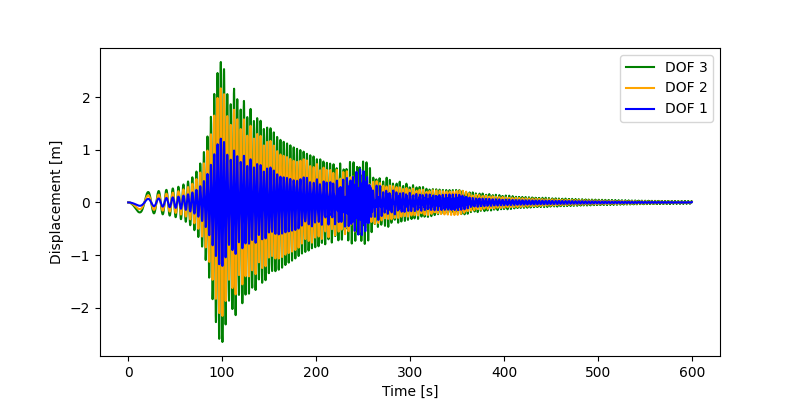

In [28]:

colors = ['blue', 'orange', 'green']

plt.figure(figsize=(8, 4))

plt.plot(t, x_t[:,2], color=colors[2], label='DOF 3')
plt.plot(t, x_t[:,1], color=colors[1], label='DOF 2')
plt.plot(t, x_t[:,0], color=colors[0], label='DOF 1')
plt.xlabel('Time [s]')
plt.ylabel('Displacement [m]')
plt.legend()
# plt.xlim(0, 550)


In [29]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle
from IPython.display import HTML


base_y = np.array([2.4, 1.6, 0.8])

# === Setup figure ===
fig, ax = plt.subplots(ncols=2, figsize=(12, 6))
ax[0].set_xlim(-1, 1)
ax[0].set_ylim(0, 3.2)
ax[0].axis('off')

# === Right subplot for displacement curves ===
for i in range(3):
    ax[1].plot(t, x_t[:, i], label=f'Mass {i+1}', zorder=2-i, color=colors[i])
moving_dots = [ax[1].plot([], [], 'o')[0] for _ in range(3)]
moving_dots = [ax[1].plot([], [], 'o', color=color)[0] for color in ['blue', 'orange', 'green']]
ax[1].set_xlim(0, t[-1])  # Ensure the full time range is shown
ax[1].set_ylim(np.min(x_t)*1.2, np.max(x_t)*1.2) 
ax[1].legend()
ax[1].set_xlabel('Time (s)')
ax[1].set_ylabel('Displacement (m)')
ax[1].grid(True, which='both', linestyle='--', linewidth=0.5, alpha=0.2)

# === Mass rectangles ===
mass_width = 0.6
mass_height = 0.2
masses = [Rectangle((-mass_width/2, y - mass_height/2), mass_width, mass_height, color=color)
          for y, color in zip(base_y, ['blue', 'orange', 'green'])]
for m in masses:
    ax[0].add_patch(m)

# === Ceiling ===
ax[0].plot([-0.5, 0.5], [3.0, 3.0], 'k', lw=4)

# === Spring utility ===
def get_spring_data(x, y0, y1, coils=4, width=0.05):
    ys = np.linspace(y0, y1, coils * 2)
    xs = np.tile([x - width, x + width], len(ys) // 2)
    if len(xs) < len(ys):
        xs = np.append(xs, x)
    return xs, ys

# === Damper drawing utility ===
def draw_damper(ax, x, y0, y1, width=0.1):
    h = y1 - y0
    rod1 = ax.plot([x, x], [y0, y0 + h * 0.3], color='black', lw=2)[0]
    box = Rectangle((x - width/2, y0 + h * 0.3), width, h * 0.2, color='black')
    ax.add_patch(box)
    rod2 = ax.plot([x, x], [y0 + h * 0.5, y1], color='black', lw=2)[0]
    return (rod1, box, rod2)

# === Initialize springs ===
springs = []
spring_y_pairs = [(3.0, base_y[0]+0.1),
                  (base_y[0]-0.1, base_y[1]+0.1),
                  (base_y[1]-0.1, base_y[2]+0.1)]
for y0, y1 in spring_y_pairs:
    xs, ys = get_spring_data(-0.2, y0, y1)
    spring_line, = ax[0].plot(xs, ys, color='gray', lw=1.5)
    springs.append(spring_line)

# === Initialize dampers ===
dampers = [draw_damper(ax[0], 0.2, y0, y1) for y0, y1 in spring_y_pairs]

time_text = ax[1].text(0.95, 0.95, '', transform=ax[1].transAxes,
                       ha='right', va='top', fontsize=10)

def update(i):
    y = base_y + x_t[i, :]  # fixed: get all 3 displacements at time step i

    # Update masses
    for j, m in enumerate(masses):
        m.set_y(y[j] - mass_height / 2)

    # Update springs
    spring_coords = [(3.0, y[0] + 0.1),
                     (y[0] - 0.1, y[1] + 0.1),
                     (y[1] - 0.1, y[2] + 0.1)]
    for j in range(3):
        xs, ys = get_spring_data(-0.2, *spring_coords[j])
        springs[j].set_data(xs, ys)

    # Update dampers
    for j in range(3):
        y0, y1 = spring_coords[j]
        h = y1 - y0
        dampers[j][0].set_data([0.2, 0.2], [y0, y0 + h * 0.3])
        dampers[j][1].set_y(y0 + h * 0.3)
        dampers[j][1].set_height(h * 0.2)
        dampers[j][2].set_data([0.2, 0.2], [y0 + h * 0.5, y1])

    # Update moving dots
    for j, dot in enumerate(moving_dots):
        dot.set_data([t[i]], [x_t[i, j]])  # also fixed here

    time_text.set_text(f"t = {t[i]:.2f} s")
    return masses + springs + [d for group in dampers for d in group] + moving_dots + [time_text]

speed = 20  # x1 (normal), x2, 0.5 for half-speed, etc.
fps = 10 * speed
duration = t[-1]  # seconds
interval = 1000 * duration / len(t) / speed

ani = animation.FuncAnimation(fig, update, frames=len(t), interval=interval)
plt.close(fig)
HTML(ani.to_jshtml())

Animation size has reached 21003449 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
ani.save('three_mass_system.gif', writer='pillow', fps=fps)